# Building Music Recommendation System using Spotify Dataset

# Import Libraries

In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# Read Data

In [2]:
data=pd.read_csv("dataset (1).csv")
data

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [3]:
data.shape

(114000, 21)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114000 entries, 0 to 113999
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        114000 non-null  int64  
 1   track_id          114000 non-null  object 
 2   artists           113999 non-null  object 
 3   album_name        113999 non-null  object 
 4   track_name        113999 non-null  object 
 5   popularity        114000 non-null  int64  
 6   duration_ms       114000 non-null  int64  
 7   explicit          114000 non-null  bool   
 8   danceability      114000 non-null  float64
 9   energy            114000 non-null  float64
 10  key               114000 non-null  int64  
 11  loudness          114000 non-null  float64
 12  mode              114000 non-null  int64  
 13  speechiness       114000 non-null  float64
 14  acousticness      114000 non-null  float64
 15  instrumentalness  114000 non-null  float64
 16  liveness          11

In [5]:
data.columns

Index(['Unnamed: 0', 'track_id', 'artists', 'album_name', 'track_name',
       'popularity', 'duration_ms', 'explicit', 'danceability', 'energy',
       'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature',
       'track_genre'],
      dtype='object')

In [6]:
data1 = data.drop(['Unnamed: 0', 'track_id'], axis=1)
data1

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [7]:
data1[data1.duplicated()].shape

(577, 19)

In [8]:
data2 = data1.drop_duplicates()
data2

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [9]:
data2.shape

(113423, 19)

In [10]:
data2[data2.duplicated()].shape

(0, 19)

In [11]:
print(data2['track_genre'].unique())

['acoustic' 'afrobeat' 'alt-rock' 'alternative' 'ambient' 'anime'
 'black-metal' 'bluegrass' 'blues' 'brazil' 'breakbeat' 'british'
 'cantopop' 'chicago-house' 'children' 'chill' 'classical' 'club' 'comedy'
 'country' 'dance' 'dancehall' 'death-metal' 'deep-house' 'detroit-techno'
 'disco' 'disney' 'drum-and-bass' 'dub' 'dubstep' 'edm' 'electro'
 'electronic' 'emo' 'folk' 'forro' 'french' 'funk' 'garage' 'german'
 'gospel' 'goth' 'grindcore' 'groove' 'grunge' 'guitar' 'happy'
 'hard-rock' 'hardcore' 'hardstyle' 'heavy-metal' 'hip-hop' 'honky-tonk'
 'house' 'idm' 'indian' 'indie-pop' 'indie' 'industrial' 'iranian'
 'j-dance' 'j-idol' 'j-pop' 'j-rock' 'jazz' 'k-pop' 'kids' 'latin'
 'latino' 'malay' 'mandopop' 'metal' 'metalcore' 'minimal-techno' 'mpb'
 'new-age' 'opera' 'pagode' 'party' 'piano' 'pop-film' 'pop' 'power-pop'
 'progressive-house' 'psych-rock' 'punk-rock' 'punk' 'r-n-b' 'reggae'
 'reggaeton' 'rock-n-roll' 'rock' 'rockabilly' 'romance' 'sad' 'salsa'
 'samba' 'sertanejo' 'show

In [12]:
data2['track_genre'].unique().shape

(114,)

In [13]:
data2['track_genre'].value_counts().head(20)

swedish              1000
sleep                1000
samba                1000
spanish              1000
ska                  1000
sertanejo            1000
sad                  1000
techno               1000
electronic           1000
reggaeton            1000
j-rock               1000
acoustic             1000
tango                1000
industrial           1000
mandopop             1000
pagode               1000
k-pop                 999
anime                 999
progressive-house     999
rockabilly            999
Name: track_genre, dtype: int64

<AxesSubplot:>

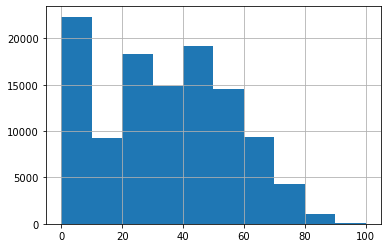

In [14]:
data2['popularity'].hist()

<AxesSubplot:>

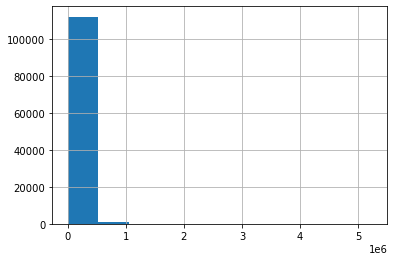

In [15]:
data2['duration_ms'].hist()

<AxesSubplot:>

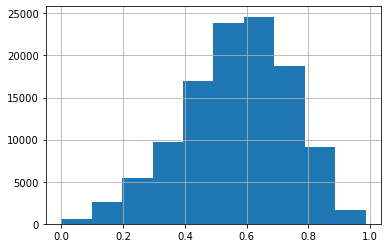

In [16]:
data2['danceability'].hist()

<AxesSubplot:>

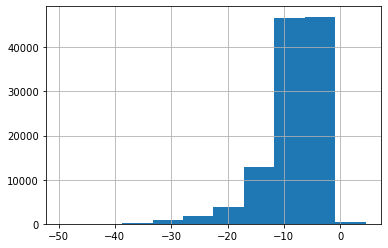

In [17]:
data2['loudness'].hist()

<AxesSubplot:>

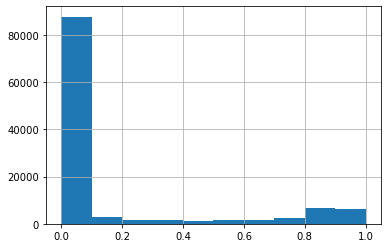

In [18]:
data2['instrumentalness'].hist()

<AxesSubplot:>

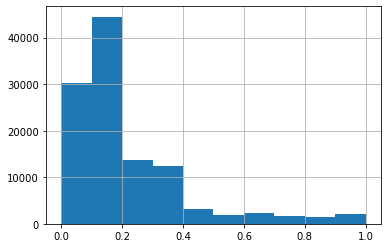

In [19]:
data2['liveness'].hist()

<AxesSubplot:>

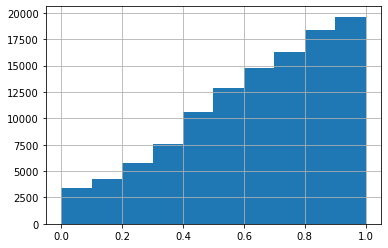

In [20]:
data2['energy'].hist()

<AxesSubplot:>

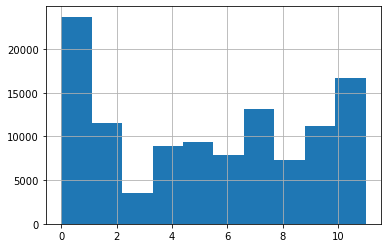

In [21]:
data2['key'].hist()

<AxesSubplot:>

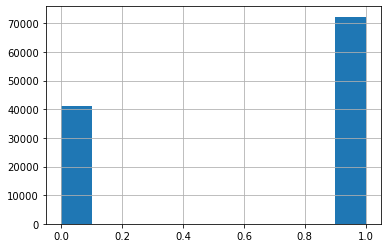

In [22]:
data2['mode'].hist()

<AxesSubplot:>

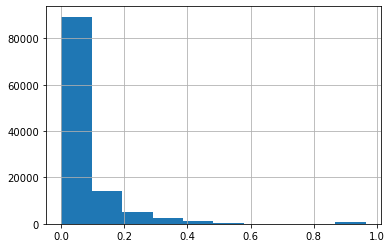

In [23]:
data2['speechiness'].hist()

<AxesSubplot:>

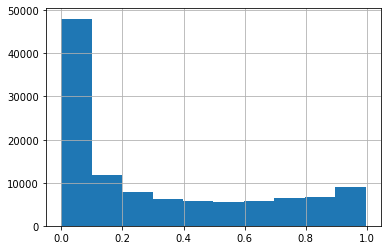

In [24]:
data2['acousticness'].hist()

In [25]:
data2.isna().sum()

artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

<AxesSubplot:>

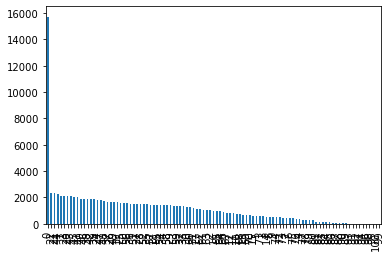

In [26]:
data2['popularity'].value_counts().plot.bar()

<AxesSubplot:>

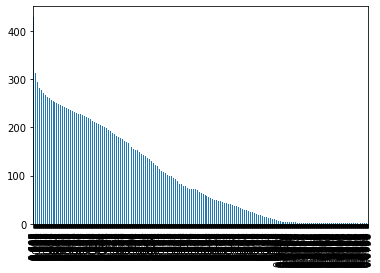

In [27]:
data2['danceability'].value_counts().plot.bar()

<AxesSubplot:>

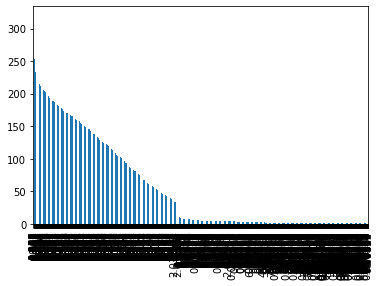

In [28]:
data2['energy'].value_counts().plot.bar()

<AxesSubplot:>

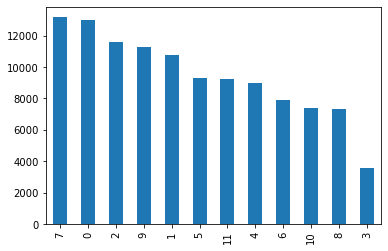

In [29]:
data2['key'].value_counts().plot.bar()

<AxesSubplot:>

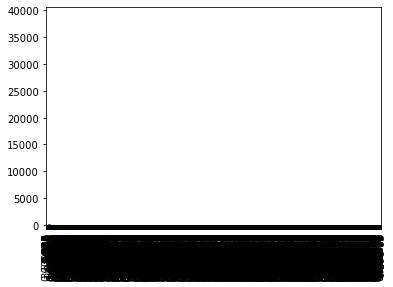

In [30]:
data2['instrumentalness'].value_counts().plot.bar()

<AxesSubplot:>

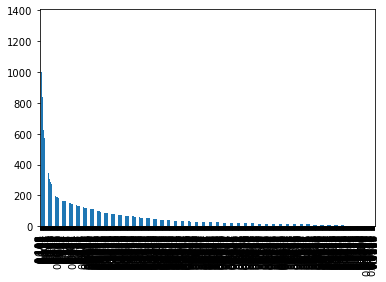

In [31]:
data2['liveness'].value_counts().plot.bar()

In [32]:
data2.describe()

,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,113423.000000,1.134230e+05,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000
mean,33.359380,2.280991e+05,0.567112,0.642174,5.309346,-8.242924,0.637675,0.084697,0.314078,0.155800,0.213609,0.474241,122.176324,3.904226
std,22.269748,1.064525e+05,0.173402,0.251030,3.559755,5.011910,0.480674,0.105802,0.331944,0.309313,0.190481,0.259239,29.972010,0.432075
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,1.741655e+05,0.456000,0.473000,2.000000,-9.998000,0.000000,0.035900,0.016800,0.000000,0.098000,0.260000,99.299000,4.000000
50%,35.000000,2.130160e+05,0.580000,0.685000,5.000000,-6.996000,1.000000,0.048900,0.168000,0.000041,0.132000,0.464000,122.019000,4.000000
75%,50.000000,2.616000e+05,0.695000,0.854000,8.000000,-5.001000,1.000000,0.084550,0.596000,0.048700,0.273000,0.683000,140.073000,4.000000
max,100.000000,5.237295e+06,0.985000,1.000000,11.000000,4.532000,1.000000,0.965000,0.996000,1.000000,1.000000,0.995000,243.372000,5.000000


<AxesSubplot:>

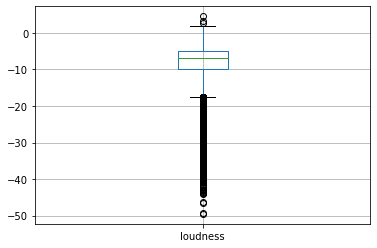

In [33]:
data2.boxplot(column="loudness")

<AxesSubplot:>

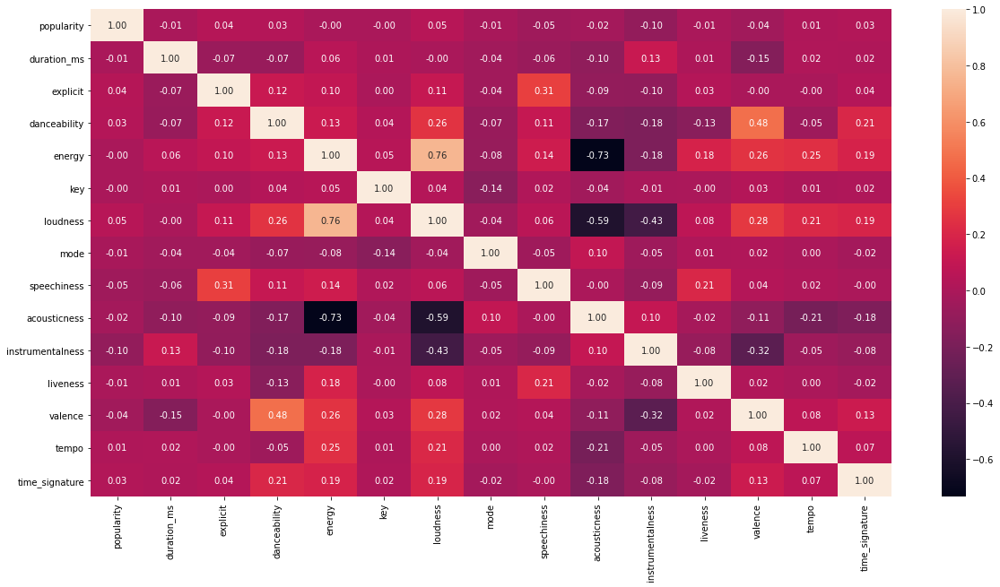

In [34]:
plt.figure(figsize=(20,10))
sns.heatmap(data2.corr(),annot=True,fmt=".2f")

# outlier detection

<AxesSubplot:>

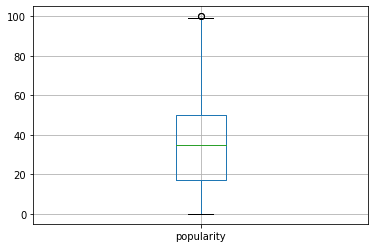

In [35]:
data2.boxplot(column="popularity")

<AxesSubplot:>

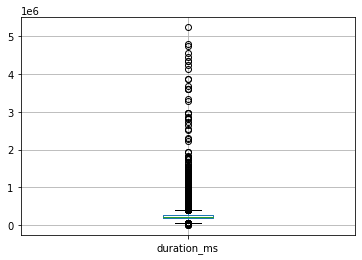

In [36]:
data2.boxplot(column="duration_ms")

<AxesSubplot:>

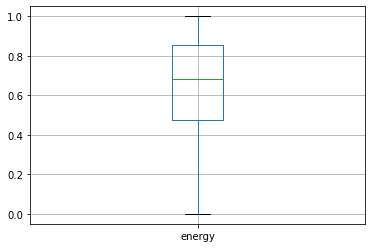

In [37]:
data2.boxplot(column="energy")

<AxesSubplot:>

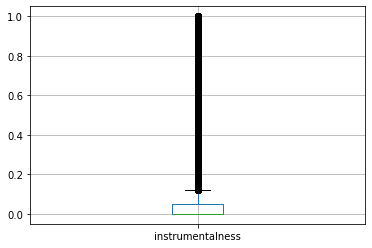

In [38]:
data2.boxplot(column="instrumentalness")

In [39]:
cols = data2.columns
cols

Index(['artists', 'album_name', 'track_name', 'popularity', 'duration_ms',
       'explicit', 'danceability', 'energy', 'key', 'loudness', 'mode',
       'speechiness', 'acousticness', 'instrumentalness', 'liveness',
       'valence', 'tempo', 'time_signature', 'track_genre'],
      dtype='object')

In [40]:
data2[cols].isnull()

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
113996,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
113997,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
113998,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


<AxesSubplot:>

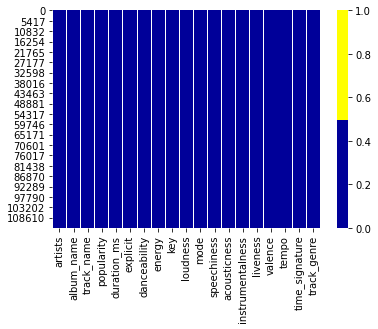

In [41]:
import seaborn as sns

colours = ['#000099', '#ffff00'] # specify the colours - yellow is missing. blue is not missing.

sns.heatmap(data2[cols].isnull(),
            cmap = sns.color_palette(colours))

In [42]:
data2.isnull().any(axis=1)

0         False
1         False
2         False
3         False
4         False
          ...  
113995    False
113996    False
113997    False
113998    False
113999    False
Length: 113423, dtype: bool

In [43]:
data2[data2.isnull().any(axis=1)]

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
65900,NaN,NaN,NaN,0,0,False,0.501,0.583,7,-9.46,0,0.0605,0.69,0.00396,0.0747,0.734,138.391,4,k-pop


In [44]:
data2[data2.isnull().any(axis=1)].shape[0]

1

In [45]:
data2.isnull().sum()

artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [46]:
#Mean Value Imputation
data2['popularity'].mean()

33.35938037258757

In [47]:
#!pip install yellowbrick

C:\ProgramData\Anaconda3\Lib\site-packages


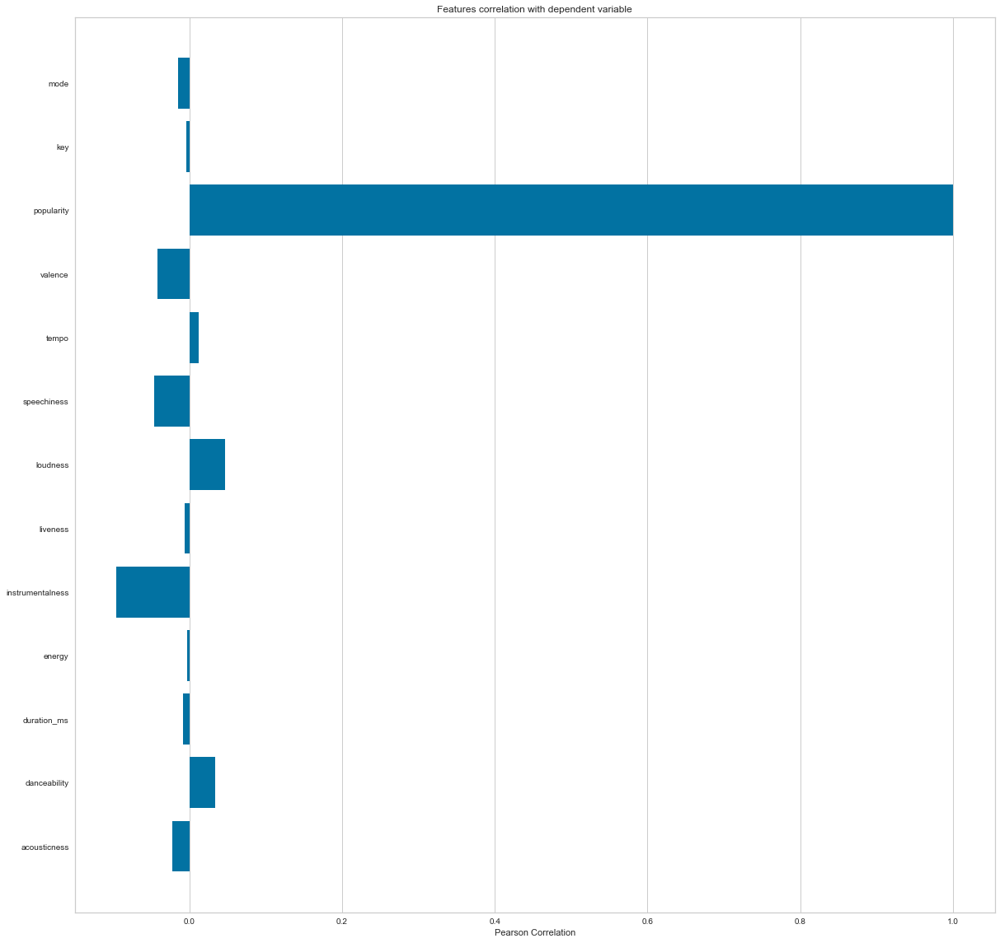

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [48]:
from distutils.sysconfig import get_python_lib
print(get_python_lib())
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo','valence','popularity','key','mode']

X, y = data2[feature_names], data2['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()



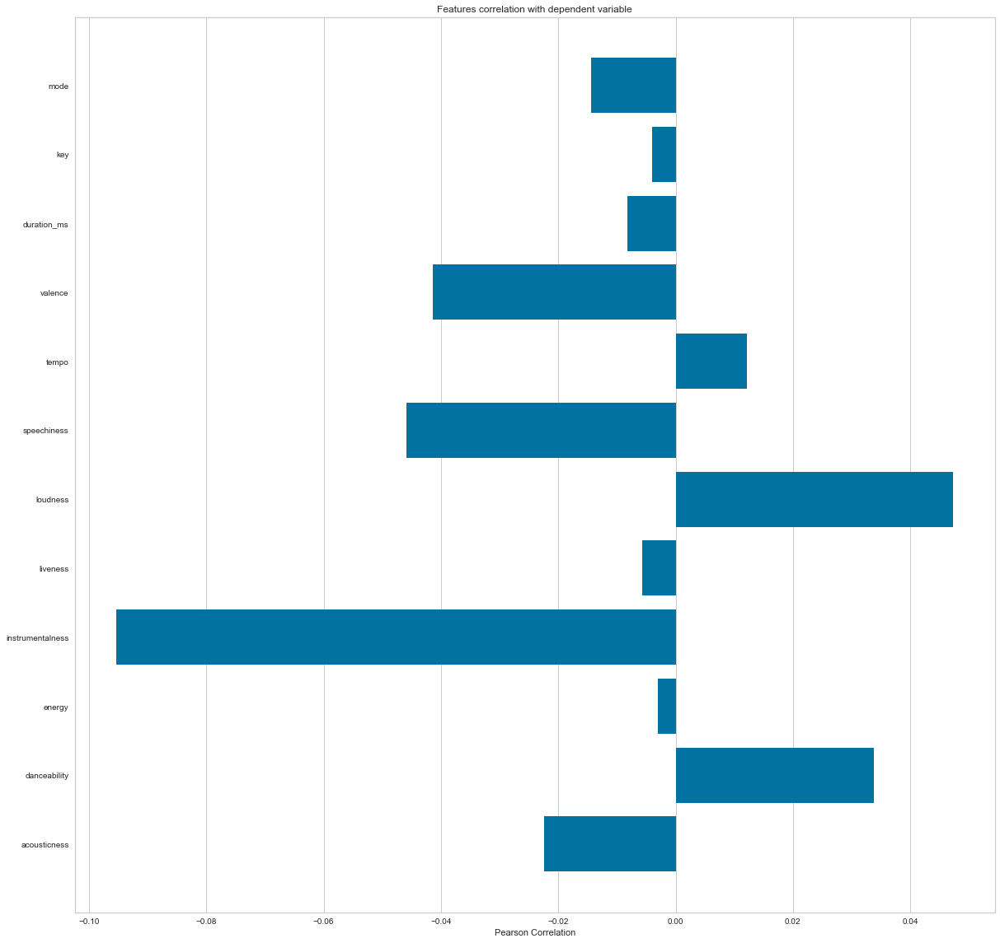

<AxesSubplot:title={'center':'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [49]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','key','mode']

X, y = data2[feature_names], data2['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

# Data Understanding by Visualization and EDA

# Music Over Time/ Duration

# AUTO EDA

In [50]:
# !pip install pandas-profiling==2.7.1

In [51]:
#import pandas_profiling as pp
#EDA_report= pp.ProfileReport(data2)
#EDA_report.to_file(output_file='repo.html')

In [52]:
#!pip install sweetviz

In [53]:
#import sweetviz as sv
#sweet_report = sv.analyze(data2)
#sweet_report.show_html('artist_report.html')

# Characteristics of Different Genres

In [54]:
top10_genres = data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='time_signature', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()


# 

# Clustering Songs with K-Means

In [55]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False,))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [56]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['popularity']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# Model Building

In [57]:
data2['tags'] = data2['artists'] + data2['track_name'] + data2['track_genre']

In [58]:
data2.head()

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,tags
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic,Gen HoshinoComedyacoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic,Ben WoodwardGhost - Acousticacoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic,Ingrid Michaelson;ZAYNTo Begin Againacoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic,Kina GrannisCan't Help Falling In Loveacoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic,Chord OverstreetHold Onacoustic


In [59]:
new_data = data2[['album_name','tags','popularity']]

In [60]:
new_data

,album_name,tags,popularity
0,Comedy,Gen HoshinoComedyacoustic,73
1,Ghost (Acoustic),Ben WoodwardGhost - Acousticacoustic,55
2,To Begin Again,Ingrid Michaelson;ZAYNTo Begin Againacoustic,57
3,Crazy Rich Asians (Original Motion Picture Sou...,Kina GrannisCan't Help Falling In Loveacoustic,71
4,Hold On,Chord OverstreetHold Onacoustic,82
...,...,...,...
113995,#mindfulness - Soft Rain for Mindful Meditatio...,Rainy LullabySleep My Little Boyworld-music,21
113996,#mindfulness - Soft Rain for Mindful Meditatio...,Rainy LullabyWater Into Lightworld-music,22
113997,Best Of,Cesária EvoraMiss Perfumadoworld-music,22
113998,Change Your World,Michael W. SmithFriendsworld-music,41


In [61]:
song_library = new_data.sort_values(by=['popularity'], ascending=False).head(5000)

In [62]:
song_library.reset_index(inplace=True, drop=True)
song_library

,album_name,tags,popularity
0,Unholy (feat. Kim Petras),Sam Smith;Kim PetrasUnholy (feat. Kim Petras)d...,100
1,Unholy (feat. Kim Petras),Sam Smith;Kim PetrasUnholy (feat. Kim Petras)pop,100
2,"Quevedo: Bzrp Music Sessions, Vol. 52","Bizarrap;QuevedoQuevedo: Bzrp Music Sessions, ...",99
3,I'm Good (Blue),David Guetta;Bebe RexhaI'm Good (Blue)edm,98
4,La Bachata,Manuel TurizoLa Bachatalatin,98
...,...,...,...
4995,Nibiru,OzunaBaila Baila Bailareggaeton,70
4996,"Smashes, Thrashes And Hits",KISSDetroit Rock Cityhard-rock,70
4997,Frozen (Original Motion Picture Soundtrack / D...,Kristen Bell;Agatha Lee Monn;Katie LopezDo You...,70
4998,Smells Like Children,Marilyn MansonSweet Dreams (Are Made Of This)i...,70


In [63]:
song_library['tags'][0]

'Sam Smith;Kim PetrasUnholy (feat. Kim Petras)dance'

In [64]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features=50,stop_words='english')

In [65]:
vectors = cv.fit_transform(song_library['tags']).toarray()

In [66]:
vectors[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0], dtype=int64)

In [67]:
from sklearn.metrics.pairwise import cosine_similarity

In [68]:
similarity = cosine_similarity(vectors)
similarity

array([[1. , 0.5, 0. , ..., 0. , 0. , 0. ],
       [0.5, 1. , 0. , ..., 0. , 0. , 0. ],
       [0. , 0. , 1. , ..., 0. , 0. , 0. ],
       ...,
       [0. , 0. , 0. , ..., 0. , 0. , 0. ],
       [0. , 0. , 0. , ..., 0. , 0. , 0. ],
       [0. , 0. , 0. , ..., 0. , 0. , 1. ]])

In [69]:
similarity[0].shape

(5000,)

In [70]:
song_library[song_library['album_name'] == 'Miss You'].index[0]

188

In [71]:
sorted(similarity[0],reverse=True)

[0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,


In [72]:
list(enumerate(similarity[0]))

[(0, 0.9999999999999998),
 (1, 0.4999999999999999),
 (2, 0.0),
 (3, 0.0),
 (4, 0.0),
 (5, 0.4999999999999999),
 (6, 0.0),
 (7, 0.0),
 (8, 0.0),
 (9, 0.0),
 (10, 0.0),
 (11, 0.0),
 (12, 0.0),
 (13, 0.0),
 (14, 0.0),
 (15, 0.0),
 (16, 0.0),
 (17, 0.0),
 (18, 0.0),
 (19, 0.0),
 (20, 0.0),
 (21, 0.0),
 (22, 0.0),
 (23, 0.0),
 (24, 0.0),
 (25, 0.0),
 (26, 0.0),
 (27, 0.0),
 (28, 0.0),
 (29, 0.0),
 (30, 0.0),
 (31, 0.0),
 (32, 0.0),
 (33, 0.0),
 (34, 0.0),
 (35, 0.0),
 (36, 0.0),
 (37, 0.0),
 (38, 0.0),
 (39, 0.0),
 (40, 0.0),
 (41, 0.0),
 (42, 0.0),
 (43, 0.0),
 (44, 0.0),
 (45, 0.0),
 (46, 0.0),
 (47, 0.0),
 (48, 0.0),
 (49, 0.816496580927726),
 (50, 0.0),
 (51, 0.0),
 (52, 0.0),
 (53, 0.0),
 (54, 0.408248290463863),
 (55, 0.0),
 (56, 0.0),
 (57, 0.0),
 (58, 0.0),
 (59, 0.0),
 (60, 0.0),
 (61, 0.0),
 (62, 0.0),
 (63, 0.0),
 (64, 0.408248290463863),
 (65, 0.0),
 (66, 0.0),
 (67, 0.0),
 (68, 0.0),
 (69, 0.0),
 (70, 0.0),
 (71, 0.0),
 (72, 0.0),
 (73, 0.0),
 (74, 0.0),
 (75, 0.0),
 (76, 0.0),

In [73]:
sorted(list(enumerate(similarity[0])),reverse=True,key=lambda x:x[1])[1:6]

[(170, 0.9999999999999998),
 (496, 0.9999999999999998),
 (525, 0.9999999999999998),
 (534, 0.9999999999999998),
 (739, 0.9999999999999998)]

In [74]:
def recommend(song):
    song_index = song_library[song_library['album_name'] == song].index[0]
    distances = similarity[song_index]
    song_list = sorted(list(enumerate(distances)),reverse=True,key=lambda x:x[1])[1:6]
    
    for i in song_list:
        print(song_library.iloc[i[0]].album_name)
       
    

In [75]:
recommend('I Love You.')

Hounds Of Love
Chit Chat
Seven Inches Of Satanic Panic
Wiped Out!
Chosen


In [76]:
song_library.iloc[3].album_name

"I'm Good (Blue)"

In [77]:
recommend('Comedy')

Unholy (feat. Kim Petras)
Quevedo: Bzrp Music Sessions, Vol. 52
I'm Good (Blue)
La Bachata
I'm Good (Blue)


In [78]:
def recommend(music):
    index = data2[data2['album_name'] == music].index[0]
    distances = sorted(list(enumerate(similarity[index])),reverse=True,key = lambda x: x[1])
 
    for i in distances[1:11]:
        a=[(data2.iloc[i[0]].album_name)],[(data2.iloc[i[0]].artists)]
#         data= pd.DataFrame(a, columns =['Track Name', 'Artist Name'],index =[i[0]])
        print(a)

In [79]:
recommend('Comedy')

(['Let Her Go'], ['Andrew Foy;Renee Foy'])
(['FTHC (Deluxe)'], ['Frank Turner'])
(['The Ghost and the Wall'], ['Joshua Radin'])
(['Finch'], ['Penny and Sparrow'])
(['IX'], ['RENT STRIKE'])
(['Chill Out Covers - Chillout Covers - Chill Acoustic - Relaxing Songs - Calming Acoustic Songs'], ['Eric Lumiere'])
(['Into The Wild (Music For The Motion Picture)'], ['Eddie Vedder'])
(['The Inevitable Train Wreck'], ['Beans on Toast'])
(["All Too Well (Jake's Version)"], ['John Elliott'])
(['Amar la trama'], ['Jorge Drexler'])


# Deployment

In [80]:
import pickle

In [81]:
pickle.dump(song_library,open('songs.pkl','wb'))

In [82]:
song_library['album_name'].values

array(['Unholy (feat. Kim Petras)', 'Unholy (feat. Kim Petras)',
       'Quevedo: Bzrp Music Sessions, Vol. 52', ...,
       'Frozen (Original Motion Picture Soundtrack / Deluxe Edition)',
       'Smells Like Children', 'Record Player (with AJR)'], dtype=object)

In [83]:
pickle.dump(song_library.to_dict(),open('songs_dict.pkl','wb'))

In [84]:
pickle.dump(similarity,open('similarity.pkl','wb'))

In [85]:
##################################################